## UBC Ovarian Cancer Subtype Classification and Outlier Detection (UBC-OCEAN)

## 1. Setup

In [1]:
!yes | sudo dpkg -i /kaggle/input/libvips-pyvips-installation-and-getting-started/libvips/*.deb
!pip install /kaggle/input/libvips-pyvips-installation-and-getting-started/pyvips/pyvips-2.2.1-py2.py3-none-any.whl --no-index --find-links /kaggle/input/libvips-pyvips-installation-and-getting-started/pyvips
!pip install /kaggle/input/ubc-ocean-dataset/packages/imagesize-1.4.1-py2.py3-none-any.whl































































































































































































































































































































































































































































































































































































































yes: standard output: Broken pipe
Looking in links: /kaggle/input/libvips-pyvips-installation-and-getting-started/pyvips
Processing /kaggle/input/libvips-pyvips-installation-and-getting-started/pyvips/pyvips-2.2.1-py2.py3-none-any.whl
Processing /kaggle/input/ubc-ocean-dataset/packages/imagesize-1.4.1-py2.py3-none-any.whl


In [2]:
import os
import yaml
from pathlib import Path
from tqdm import tqdm

import numpy as np
import pandas as pd

os.environ['OPENCV_IO_MAX_IMAGE_PIXELS'] = str(pow(2, 40))
import cv2
import pyvips
import imagesize

import torch
import torch.nn as nn
import torch.nn.functional as F
import timm

import albumentations as A
from albumentations.pytorch.transforms import ToTensorV2

import matplotlib.pyplot as plt

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [3]:
competition_dataset = Path('/kaggle/input/UBC-OCEAN')
external_dataset = Path('/kaggle/input/ubc-ocean-dataset')

In [4]:
df = pd.read_csv(competition_dataset / 'test.csv')
is_submission = df.shape[0] != 1

df['image_type'] = 'wsi'
df.loc[(df['image_width'] < 4000) & (df['image_height'] < 4000), 'image_type'] = 'tma'
df['image_path'] = df['image_id'].apply(lambda x: str(competition_dataset / 'test_images' / f'{str(x)}.png'))

print(f'Dataset Shape: {df.shape}')

Dataset Shape: (1, 5)


## 2. Image Utilities

In [5]:
def read_image(image_path):
    
    """
    Read image using libvips

    Parameters
    ----------
    image_path: str
        Path of the image

    Returns
    -------
    image: numpy.ndarray of shape (height, width, 3)
        Image array
    """
    
    image = pyvips.Image.new_from_file(image_path, access='sequential')

    return np.ndarray(
        buffer=image.write_to_memory(),
        dtype=np.uint8,
        shape=[image.height, image.width, image.bands]
    )


def resize_with_aspect_ratio(image, longest_edge, interpolation=cv2.INTER_LINEAR):

    """
    Resize image while preserving its aspect ratio

    Parameters
    ----------
    image: numpy.ndarray of shape (height, width, 3)
        Image array

    longest_edge: int
        Desired number of pixels on the longest edge

    interpolation: int
        OpenCV interpolation enum

    Returns
    -------
    image: numpy.ndarray of shape (resized_height, resized_width, 3)
        Resized image array
    """

    height, width = image.shape[:2]
    scale = longest_edge / max(height, width)
    image = cv2.resize(image, dsize=(int(np.ceil(width * scale)), int(np.ceil(height * scale))), interpolation=interpolation)

    return image


def drop_low_std(image, threshold):

    """
    Drop rows and columns that are below the given standard deviation threshold

    Parameters
    ----------
    image: numpy.ndarray of shape (height, width, 3)
        Image array

    threshold: int
        Standard deviation threshold

    Returns
    -------
    image: numpy.ndarray of shape (cropped_height, cropped_width, 3)
        Cropped image array
    """

    vertical_stds = image.std(axis=(1, 2))
    horizontal_stds = image.std(axis=(0, 2))
    cropped_image = image[vertical_stds > threshold, :, :]
    cropped_image = cropped_image[:, horizontal_stds > threshold, :]

    return cropped_image


def get_largest_contour(image, threshold):

    """
    Get the largest contour from the image

    Parameters
    ----------
    image: numpy.ndarray of shape (height, width)
        Image array

    threshold: int
        Binarization threshold

    Returns
    -------
    bounding_box: list of shape (4)
        Bounding box with x1, y1, x2, y2 values
    """
    
    image_shape = image.shape[:2]
    image = cv2.threshold(image, threshold, 255, cv2.THRESH_BINARY)[1]
    contours, _ = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    del image
    
    if len(contours) == 0:
        x1 = 0
        x2 = image_shape[1] + 1
        y1 = 0
        y2 = image_shape[0] + 1
    else:
        contour = max(contours, key=cv2.contourArea)
        mask = np.zeros(image_shape, np.uint8)
        cv2.drawContours(mask, [contour], -1, 255, cv2.FILLED)

        y1, y2 = np.min(contour[:, :, 1]), np.max(contour[:, :, 1])
        x1, x2 = np.min(contour[:, :, 0]), np.max(contour[:, :, 0])

        x1 = int(0.999 * x1)
        x2 = int(1.001 * x2)
        y1 = int(0.999 * y1)
        y2 = int(1.001 * y2)

    bounding_box = [x1, y1, min(x2, image_shape[1]), min(y2, image_shape[0])]

    return bounding_box


In [6]:
def visualize_image(image, title, mask=None, path=None):

    """
    Visualize the given image

    Parameters
    ----------
    image: numpy.ndarray of shape (height, width, channel)
        Image array

    title: str
        Title of the plot

    mask: numpy.ndarray of shape (height, width)
        Mask array

    path: str or None
        Path of the output file or None (if path is None, plot is displayed with selected backend)
    """

    fig, ax = plt.subplots(figsize=(8, 8))
    ax.imshow(image)
    if mask is not None:
        ax.imshow(mask, alpha=0.5)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.tick_params(axis='x', labelsize=15, pad=10)
    ax.tick_params(axis='y', labelsize=15, pad=10)
    ax.set_title(title, size=15, pad=12.5, loc='center', wrap=True)

    if path is None:
        plt.show()
    else:
        plt.savefig(path)
        plt.close(fig)


## 3. Models

In [7]:
class Decoder(nn.Module):

    def __init__(self, encoder_dim=(32, 64, 128, 256), upscale=4, num_classes=1):

        super(Decoder, self).__init__()

        self.conv = nn.ModuleList([
            nn.Sequential(
                nn.Conv2d(encoder_dim[i] + encoder_dim[i - 1], encoder_dim[i - 1], 3, 1, 1, bias=False),
                nn.BatchNorm2d(encoder_dim[i - 1]),
                nn.ReLU(inplace=True)
            ) for i in range(1, len(encoder_dim))
        ])

        self.logit = nn.Conv2d(encoder_dim[0], num_classes, 1, 1, 0)
        self.up = nn.Upsample(scale_factor=upscale, mode='bilinear')

    def forward(self, feature):

        for i in range(len(feature) - 1, 0, -1):
            f_up = F.interpolate(feature[i], scale_factor=2, mode='bilinear')
            f = torch.cat([feature[i - 1], f_up], dim=1)
            f_down = self.conv[i - 1](f)
            feature[i - 1] = f_down

        x = self.logit(feature[0])
        out = self.up(x)

        return out


class SegModel(nn.Module):

    def __init__(self, num_classes):

        super(SegModel, self).__init__()

        self.encoder = timm.create_model(
            'maxvit_tiny_tf_512.in1k',
            features_only=True,
            pretrained=False,
            out_indices=[1, 2, 3, 4]
        )

        self.decoder = Decoder(
            self.encoder.feature_info.channels(),
            upscale=self.encoder.feature_info.reduction()[0],
            num_classes=num_classes
        )

    def forward(self, x):

        feat_maps = self.encoder(x)
        logits = self.decoder(feat_maps)
        masks = torch.sigmoid(logits)

        return masks

In [8]:
class ClassificationHead(nn.Module):

    def __init__(self, input_dimensions, cancer_output_dimensions):

        super(ClassificationHead, self).__init__()

        self.cancer_head = nn.Linear(input_dimensions, cancer_output_dimensions, bias=True)

    def forward(self, x):

        cancer_output = self.cancer_head(x)

        return cancer_output


class TimmConvImageClassificationModel(nn.Module):

    def __init__(self, model_name, pretrained, backbone_args, pooling_type, dropout_rate, freeze_parameters, head_args):

        super(TimmConvImageClassificationModel, self).__init__()

        self.backbone = timm.create_model(
            model_name=model_name,
            pretrained=pretrained,
            **backbone_args
        )

        if freeze_parameters:
            for parameter in self.backbone.parameters():
                parameter.requires_grad = False

        input_features = self.backbone.get_classifier().in_features

        self.pooling_type = pooling_type
        self.dropout = nn.Dropout(dropout_rate) if dropout_rate > 0 else nn.Identity()
        self.head = ClassificationHead(input_dimensions=input_features, **head_args)

    def forward(self, x):

        x = self.backbone.forward_features(x)

        if self.pooling_type == 'avg':
            x = F.adaptive_avg_pool2d(x, output_size=(1, 1)).view(x.size(0), -1)
        elif self.pooling_type == 'max':
            x = F.adaptive_max_pool2d(x, output_size=(1, 1)).view(x.size(0), -1)
        elif self.pooling_type == 'concat':
            x = torch.cat([
                F.adaptive_avg_pool2d(x, output_size=(1, 1)).view(x.size(0), -1),
                F.adaptive_max_pool2d(x, output_size=(1, 1)).view(x.size(0), -1)
            ], dim=-1)

        x = self.dropout(x)
        cancer_output = self.head(x)

        return cancer_output


In [9]:
def load_segmentation_model(model_directory, model_file_name, device):
    
    """
    Load model and pretrained weights from the given model directory

    Parameters
    ----------
    model_directory: pathlib.Path
        Path of the model directory

    model_file_name: str
        Name of the model weights file

    device: torch.device
        Location of the model

    Returns
    -------
    model: torch.nn.Module
        Model with weights loaded
    """

    model = SegModel(num_classes=1)
    model.load_state_dict(torch.load(model_directory / model_file_name), strict=True)
    model.to(device)
    model.eval()
    print(f'{model.__class__.__name__} model\'s weights are loaded from {model_directory / model_file_name}')

    return model


def load_classification_model(model_directory, model_file_names, device):
    
    """
    Load model and pretrained weights from the given model directory

    Parameters
    ----------
    model_directory: pathlib.Path
        Path of the model directory

    model_file_names: list
        List of names of the model weights files

    device: torch.device
        Location of the model

    Returns
    -------
    model: dict
        Dictionary of models with weights loaded
    """

    config = yaml.load(open(model_directory / 'config.yaml', 'r'), Loader=yaml.FullLoader)
    config['model']['model_args']['pretrained'] = False
        
    models = {}

    for model_file_name in model_file_names:
        model = eval(config['model']['model_class'])(**config['model']['model_args'])
        model.load_state_dict(torch.load(model_directory / model_file_name))
        model.to(device)
        model.eval()
        models[model_file_name] = model
        print(f'{model.__class__.__name__} model\'s weights are loaded from {model_directory / model_file_name}')

    return models, config


In [10]:
segmentation_model = load_segmentation_model(
    model_directory=external_dataset / 'segmentation',
    model_file_name='maxvit_tiny_512_v1_final_epoch_13.pt',
    device=torch.device('cuda')
)

models, config = load_classification_model(
    model_directory=external_dataset / 'efficientnetv2s_1024_crop_16_v2.1',
    model_file_names=[
        'model_fold1_epoch_8.pt',
        'model_fold2_epoch_15.pt',
        'model_fold3_epoch_15.pt',
        'model_fold4_epoch_15.pt',
        'model_fold5_epoch_14.pt',
    ],
    device=torch.device('cuda')
)


SegModel model's weights are loaded from /kaggle/input/ubc-ocean-dataset/segmentation/maxvit_tiny_512_v1_final_epoch_13.pt
TimmConvImageClassificationModel model's weights are loaded from /kaggle/input/ubc-ocean-dataset/efficientnetv2s_1024_crop_16_v2.1/model_fold1_epoch_8.pt
TimmConvImageClassificationModel model's weights are loaded from /kaggle/input/ubc-ocean-dataset/efficientnetv2s_1024_crop_16_v2.1/model_fold2_epoch_15.pt
TimmConvImageClassificationModel model's weights are loaded from /kaggle/input/ubc-ocean-dataset/efficientnetv2s_1024_crop_16_v2.1/model_fold3_epoch_15.pt
TimmConvImageClassificationModel model's weights are loaded from /kaggle/input/ubc-ocean-dataset/efficientnetv2s_1024_crop_16_v2.1/model_fold4_epoch_15.pt
TimmConvImageClassificationModel model's weights are loaded from /kaggle/input/ubc-ocean-dataset/efficientnetv2s_1024_crop_16_v2.1/model_fold5_epoch_14.pt


## 4. Inference

In [11]:
segmentation_size = 384
segmentation_device = torch.device('cuda')
segmentation_amp = True

segmentation_transforms = A.Compose([
    A.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
    ToTensorV2()
])

In [12]:
classification_crop_size = 1024
classification_top_n_crops = 16

classification_device = torch.device('cuda')
classification_amp = True

tta = False
tta_flip_dimensions = [(2,), (3,), (2, 3)]

classification_transforms = A.Compose([
    A.Resize(
        height=1024,
        width=1024,
        interpolation=cv2.INTER_NEAREST,
        always_apply=True
    ),
    A.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225],
        max_pixel_value=255,
        always_apply=True
    ),
    ToTensorV2(always_apply=True)
])

In [13]:
def get_max_quo(num, div):
    quo, rem = divmod(num, div)
    max_quo = quo + 1 if rem > 0 else quo
    return max_quo


Image 41 (1790, 3000, 3) thumbnail is loaded from /kaggle/input/UBC-OCEAN/test_thumbnails/41_thumbnail.png


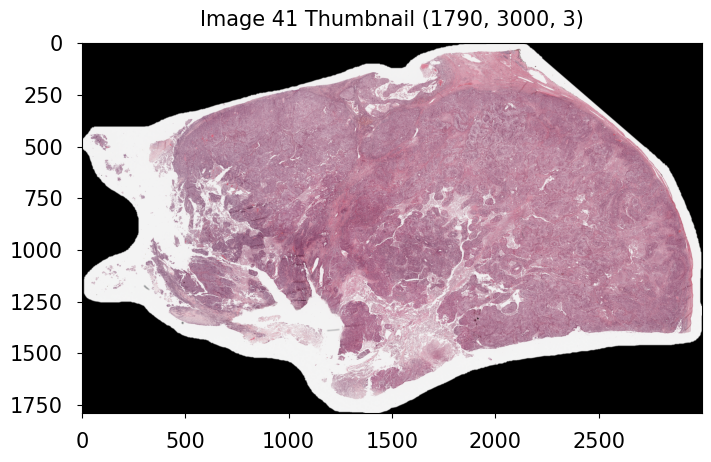

Image 41 (2048, 3200, 3) thumbnail and mask (1920, 3072) are padded


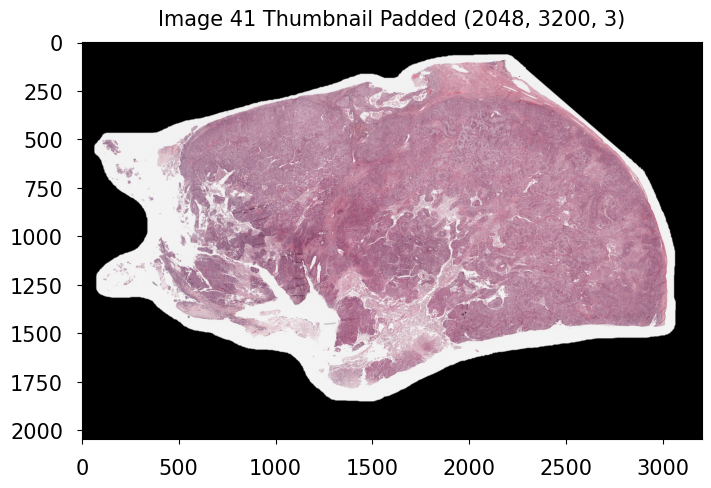

Predicted x (0-384) y (0-384)
Predicted x (384-768) y (0-384)
Predicted x (768-1152) y (0-384)
Predicted x (1152-1536) y (0-384)
Predicted x (1536-1920) y (0-384)
Predicted x (1920-2304) y (0-384)
Predicted x (2304-2688) y (0-384)
Predicted x (2688-3072) y (0-384)
Predicted x (0-384) y (384-768)
Predicted x (384-768) y (384-768)
Predicted x (768-1152) y (384-768)
Predicted x (1152-1536) y (384-768)
Predicted x (1536-1920) y (384-768)
Predicted x (1920-2304) y (384-768)
Predicted x (2304-2688) y (384-768)
Predicted x (2688-3072) y (384-768)
Predicted x (0-384) y (768-1152)
Predicted x (384-768) y (768-1152)
Predicted x (768-1152) y (768-1152)
Predicted x (1152-1536) y (768-1152)
Predicted x (1536-1920) y (768-1152)
Predicted x (1920-2304) y (768-1152)
Predicted x (2304-2688) y (768-1152)
Predicted x (2688-3072) y (768-1152)
Predicted x (0-384) y (1152-1536)
Predicted x (384-768) y (1152-1536)
Predicted x (768-1152) y (1152-1536)
Predicted x (1152-1536) y (1152-1536)
Predicted x (1536-19

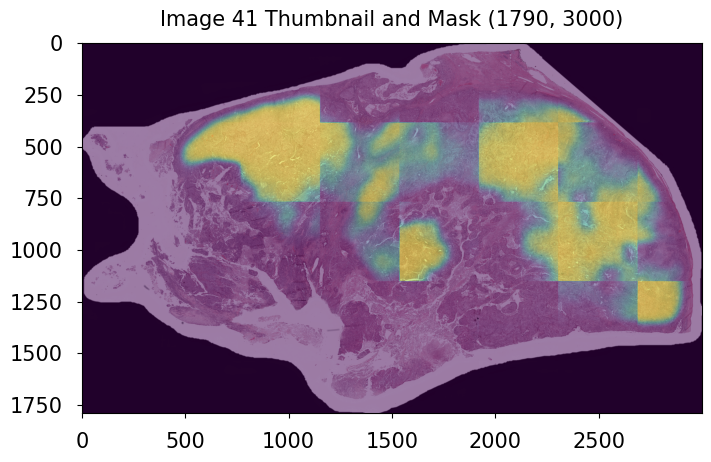

Image 41 mask (16987, 28469) is upsampled


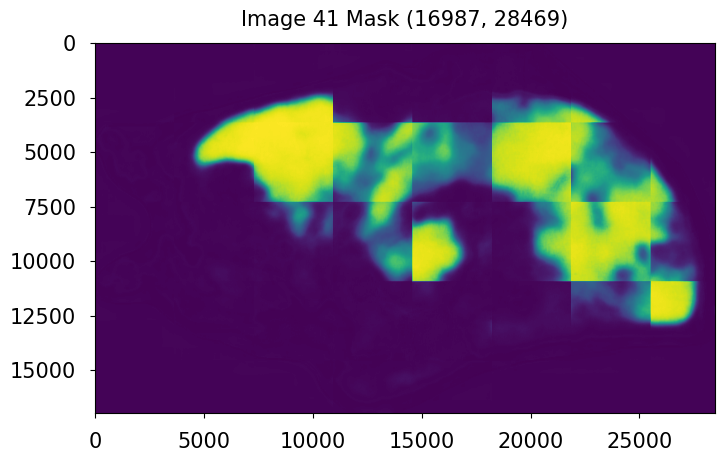

476 crops are extracted from the mask
Image 41 crop 0


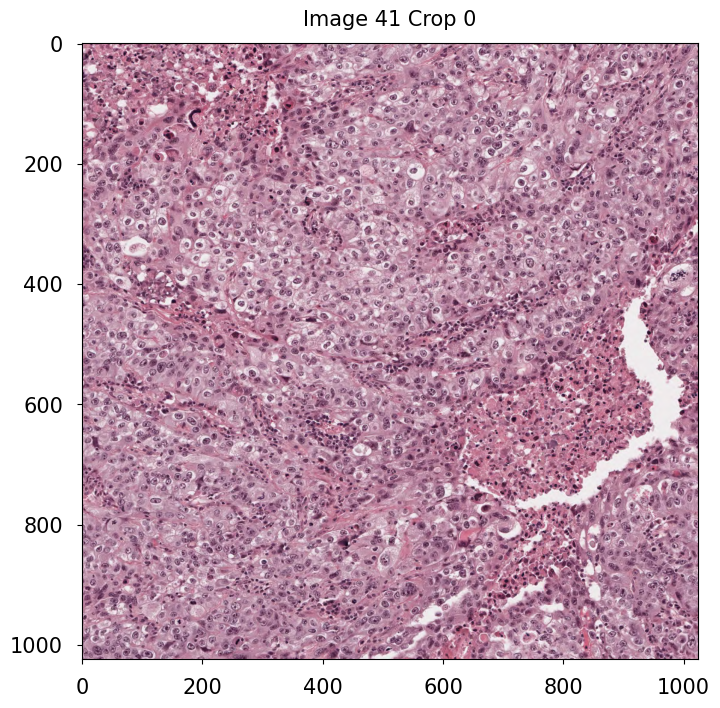

Image 41 crop 1


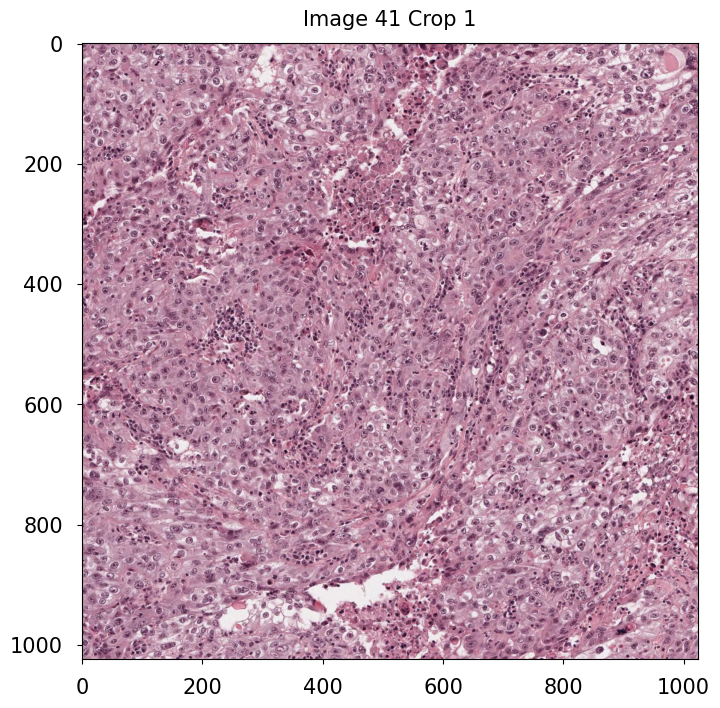

Image 41 crop 2


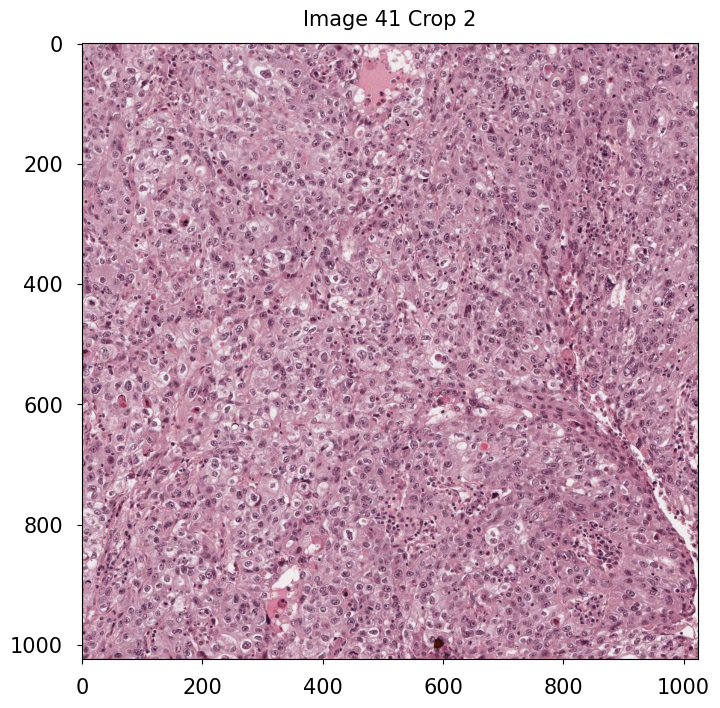

Image 41 crop 3


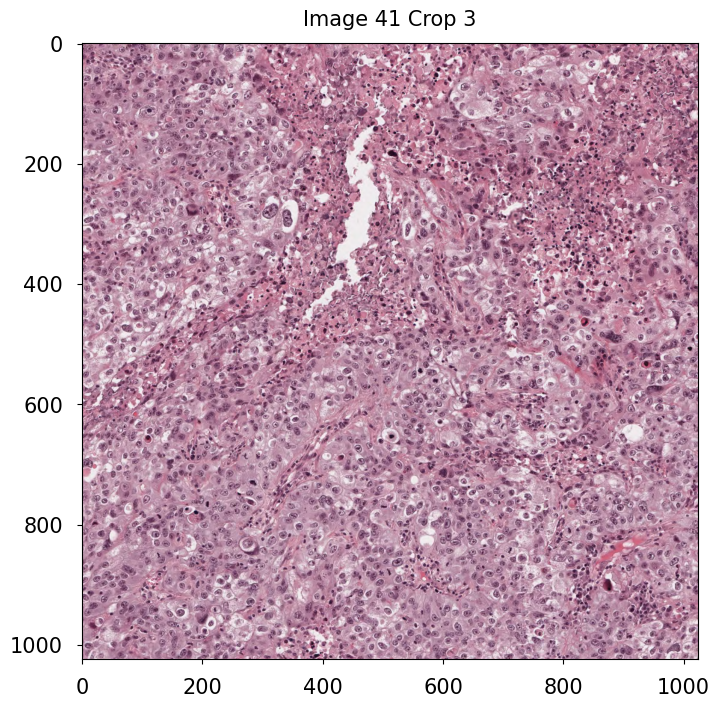

Image 41 crop 4


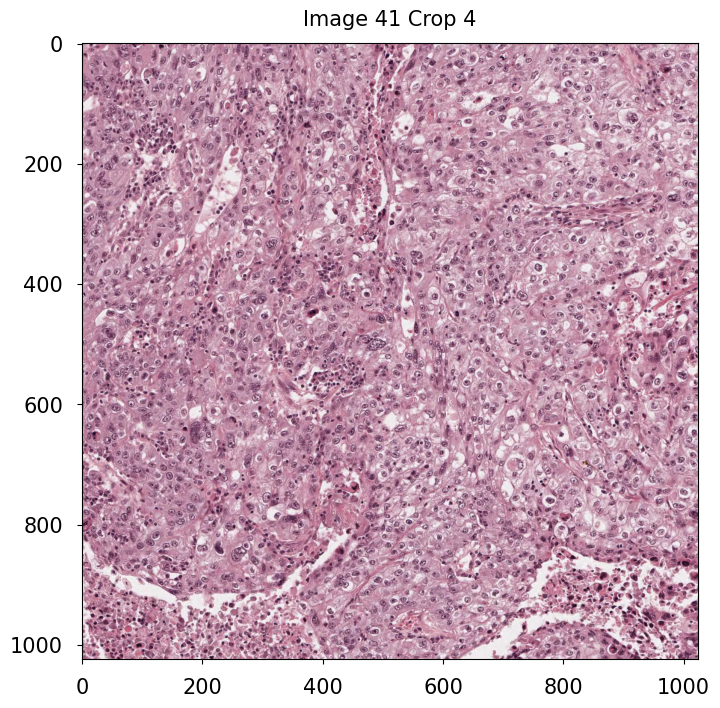

Image 41 crop 5


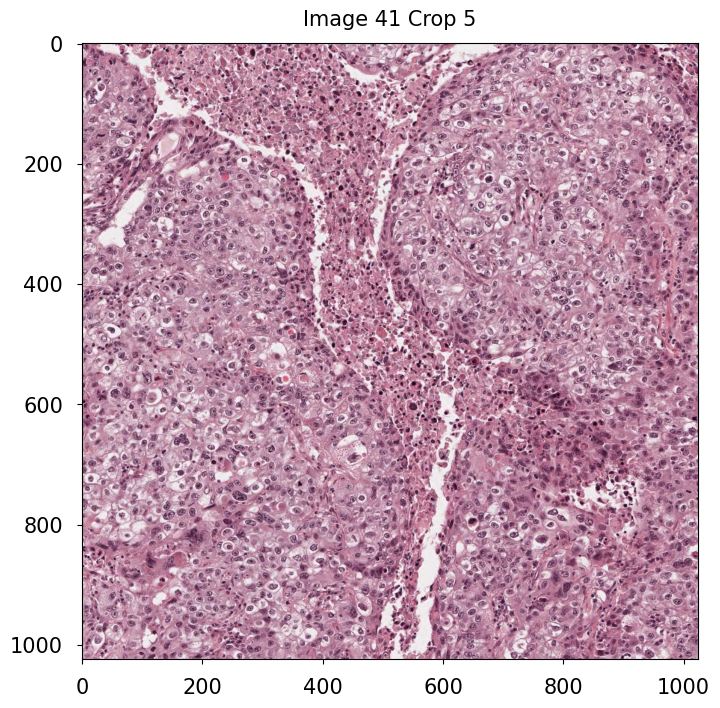

Image 41 crop 6


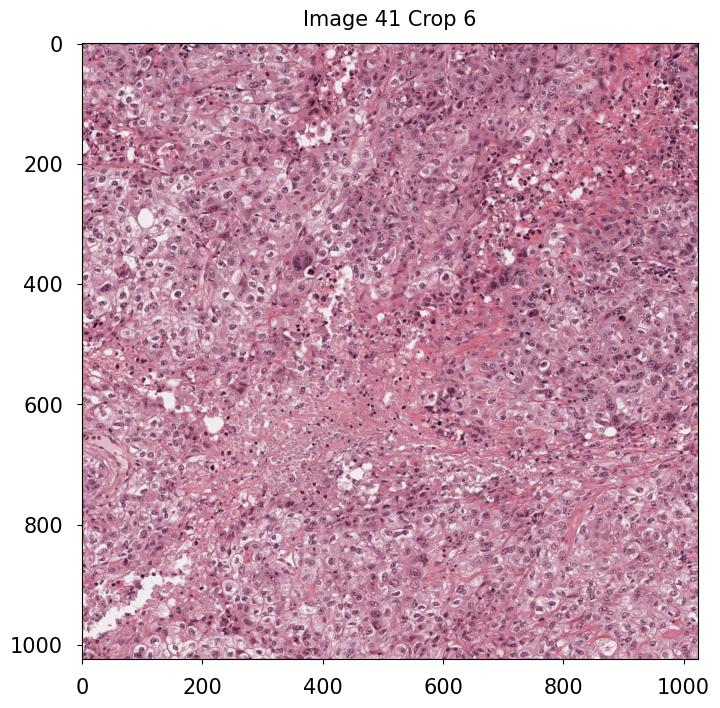

Image 41 crop 7


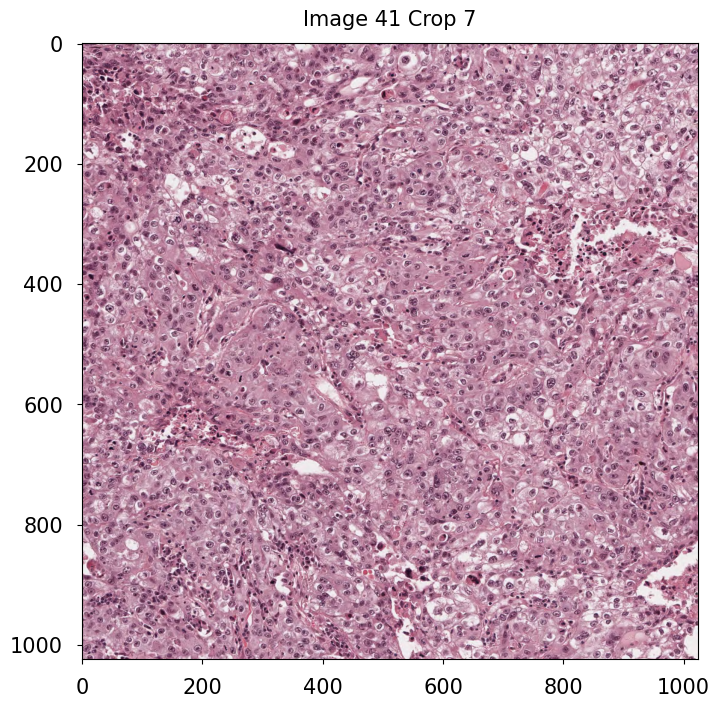

Image 41 crop 8


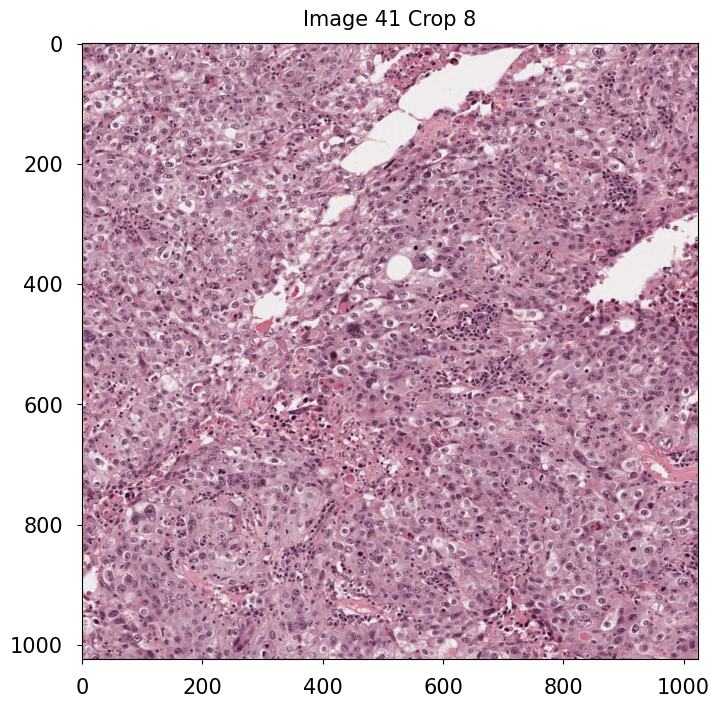

Image 41 crop 9


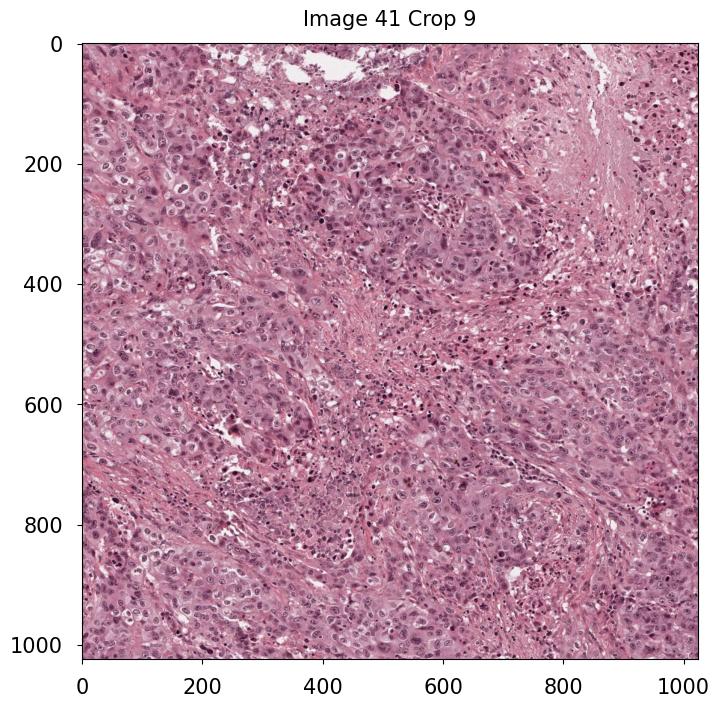

Image 41 crop 10


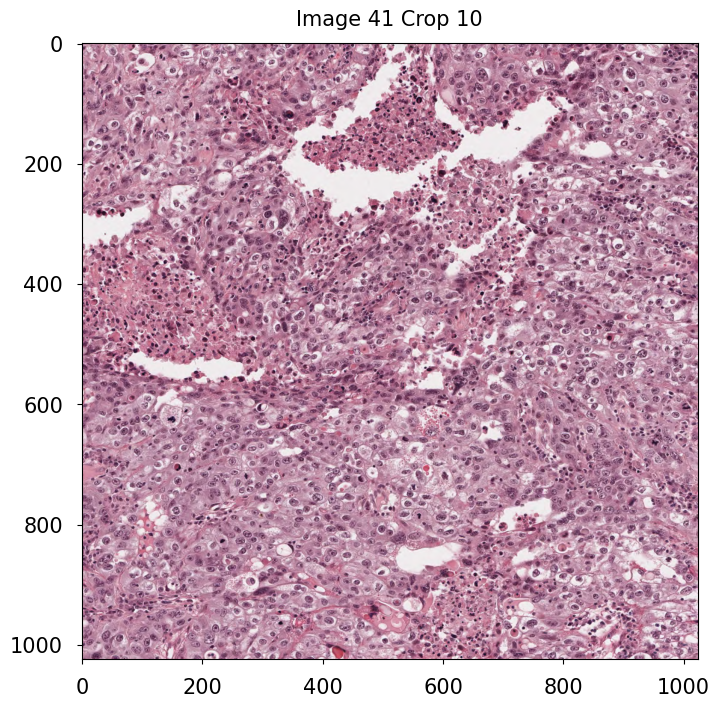

Image 41 crop 11


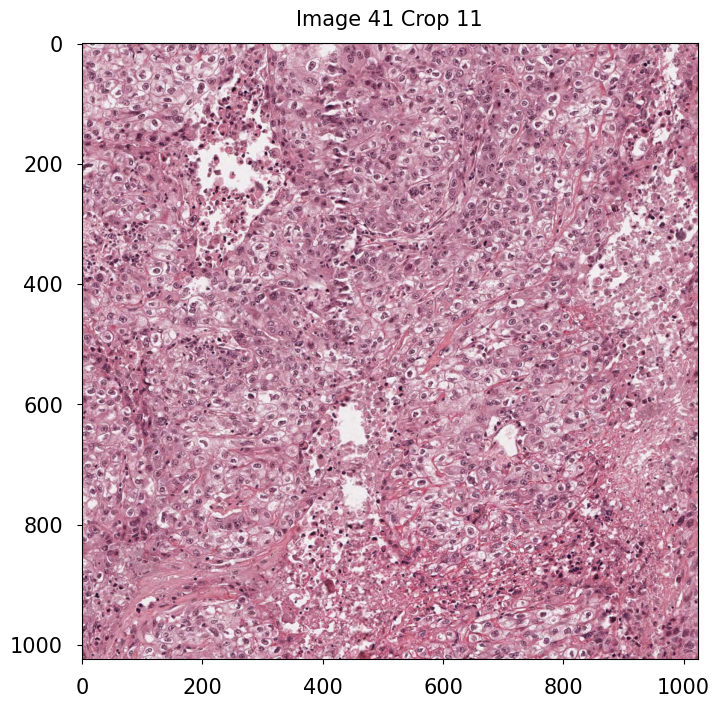

Image 41 crop 12


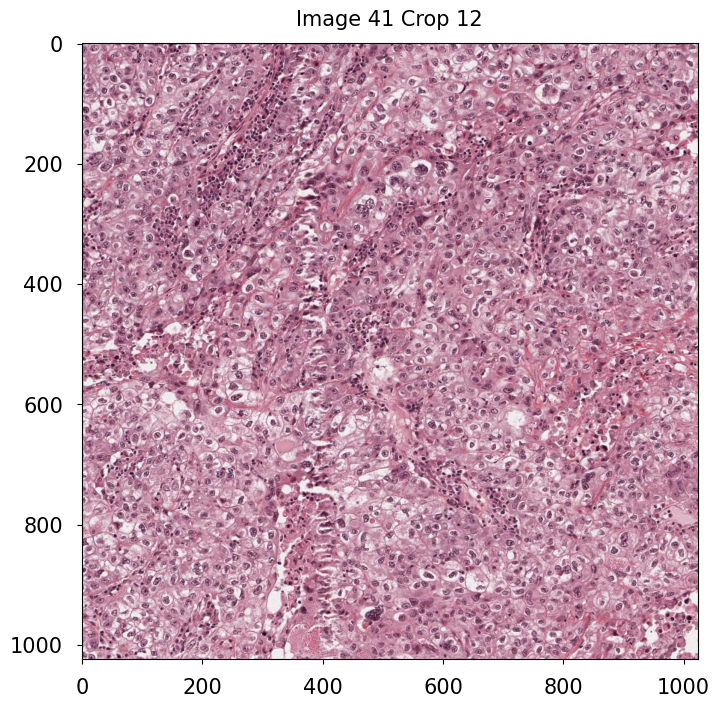

Image 41 crop 13


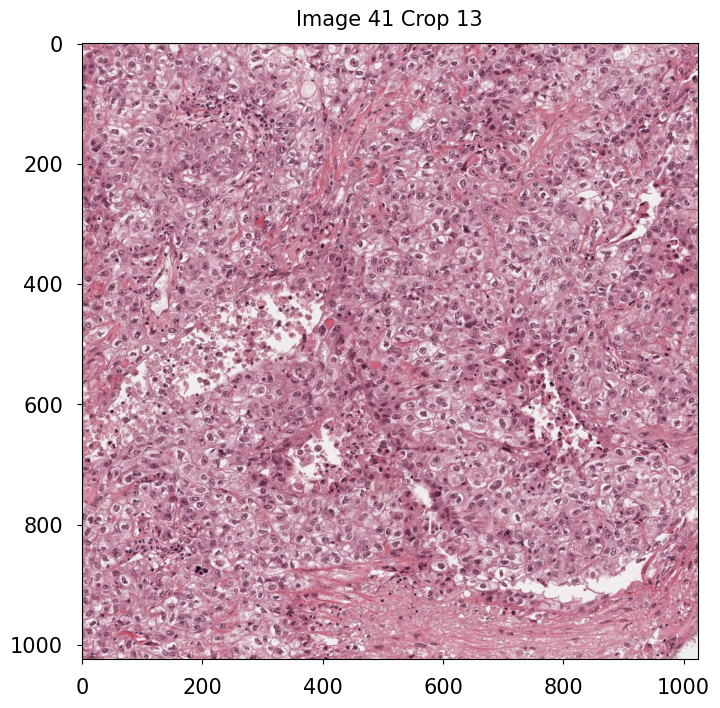

Image 41 crop 14


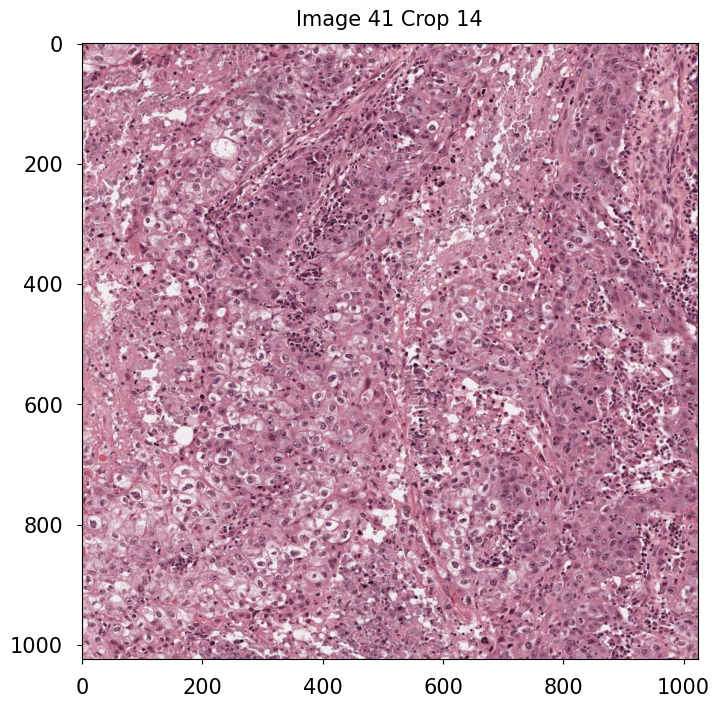

Image 41 crop 15


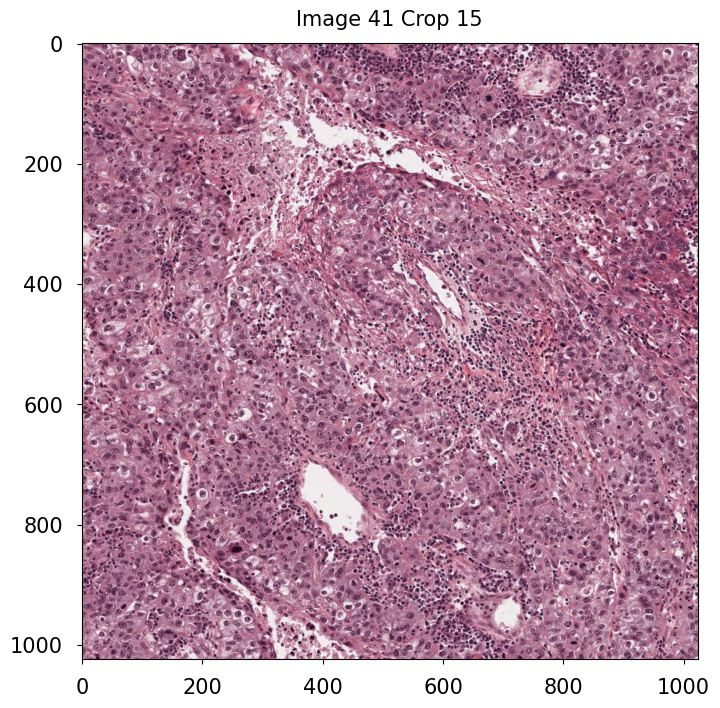

In [14]:
predictions = []
image_ids = []

for idx, row in df.iterrows():
    
    image_id = row['image_id']
    image_type = row['image_type']
    image_path = row['image_path']
    
    if image_type == 'tma':

        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Drop low standard deviation rows and columns (white areas with less tissue)
        image = drop_low_std(image=image, threshold=10)
        
        tma_predictions = torch.zeros(1, 6)
        
        inputs = classification_transforms(image=image)['image']
        inputs = inputs.to(classification_device)

        if tta:
            inputs = torch.stack((
                inputs,
                torch.flip(inputs, dims=(1,)),
                torch.flip(inputs, dims=(2,)),
                torch.flip(inputs, dims=(1, 2))
            ), dim=0)
        else:
            inputs = torch.unsqueeze(inputs, dim=0)

        for model_idx, models in enumerate([models]):
            for model in models.values():
                with torch.no_grad():
                    if classification_amp:
                        with torch.autocast(device_type='cuda', dtype=torch.float16):
                            outputs = model(inputs)
                    else:
                        outputs = model(inputs)

                outputs = outputs.cpu()
                if tta:
                    outputs = torch.mean(outputs, dim=0)
                else:
                    outputs = torch.squeeze(outputs, dim=0)

                tma_predictions += outputs / len(models)
                
        tma_predictions = torch.softmax(tma_predictions, dim=-1).numpy()
        predictions.append(tma_predictions)
        image_ids.append(np.array([image_id]))
        
    else:
        
        image_thumbnail_path = str(competition_dataset / 'test_thumbnails' / f'{image_id}_thumbnail.png')
        image_thumbnail = cv2.imread(image_thumbnail_path)
        image_thumbnail = cv2.cvtColor(image_thumbnail, cv2.COLOR_BGR2RGB)
        
        if is_submission is False:
            print(f'Image {image_id} {image_thumbnail.shape} thumbnail is loaded from {image_thumbnail_path}')
            visualize_image(image=image_thumbnail, title=f'Image {image_id} Thumbnail {image_thumbnail.shape}')
            
        image_thumbnail_height, image_thumbnail_width = image_thumbnail.shape[:2]
        thumbnail_height_padding = segmentation_size - image_thumbnail_height % segmentation_size
        thumbnail_width_padding = segmentation_size - image_thumbnail_width % segmentation_size
        image_thumbnail_padded = np.pad(image_thumbnail, ((0 + 64, thumbnail_height_padding + 64), (0 + 64, thumbnail_width_padding + 64), (0, 0)))
        mask_padded = np.zeros((image_thumbnail_height + thumbnail_height_padding, image_thumbnail_width + thumbnail_width_padding), dtype=np.float32)
        
        if is_submission is False:
            print(f'Image {image_id} {image_thumbnail_padded.shape} thumbnail and mask {mask_padded.shape} are padded')
            visualize_image(image=image_thumbnail_padded, title=f'Image {image_id} Thumbnail Padded {image_thumbnail_padded.shape}')
        
        for height in range((image_thumbnail_height + thumbnail_height_padding) // segmentation_size):
            height_1, height_2 = height * segmentation_size, (height + 1) * segmentation_size
            for width in range((image_thumbnail_width + thumbnail_width_padding) // segmentation_size):
                width_1, width_2 = width * segmentation_size, (width + 1) * segmentation_size
                
                image_thumbnail_tile = image_thumbnail_padded[height_1:height_2 + 128, width_1:width_2 + 128]
                inputs = segmentation_transforms(image=image_thumbnail_tile)['image'].to(segmentation_device)
                inputs = torch.stack((
                    inputs,
                    torch.flip(inputs, dims=(1,)),
                    torch.flip(inputs, dims=(2,)),
                    torch.flip(inputs, dims=(1, 2))
                ), dim=0)
                
                with torch.no_grad():
                    if segmentation_amp:
                        with torch.autocast(device_type='cuda', dtype=torch.float16):
                            outputs = segmentation_model(inputs)
                    else:
                        outputs = segmentation_model(inputs)
                    
                outputs = outputs.cpu()
                outputs = torch.stack((
                    outputs[0],
                    torch.flip(outputs[1], dims=(1,)),
                    torch.flip(outputs[2], dims=(2,)),
                    torch.flip(outputs[3], dims=(1, 2)),
                ), dim=0)
                outputs = torch.mean(outputs, dim=0).squeeze().cpu().numpy()
                mask_padded[height_1:height_2, width_1:width_2] = outputs[64:448, 64:448]
                    
                if is_submission is False:
                    print(f'Predicted x ({width_1}-{width_2}) y ({height_1}-{height_2})')
                        
        mask = mask_padded[:image_thumbnail_height, :image_thumbnail_width]
        del mask_padded
        
        if is_submission is False:
            print(f'Image {image_id} {mask.shape} mask is predicted')
            visualize_image(image=image_thumbnail, title=f'Image {image_id} Thumbnail and Mask {mask.shape}', mask=mask)
            
        # Extract image size from the image headers
        image_width, image_height = imagesize.get(image_path)
        # Cast mask soft predictions to 8-bit integer and upsample
        mask = np.uint8(mask * 255)
        mask = cv2.resize(mask, (image_width, image_height), cv2.INTER_NEAREST)
        
        if is_submission is False:
            print(f'Image {image_id} mask {mask.shape} is upsampled')
            visualize_image(image=mask, title=f'Image {image_id} Mask {mask.shape}')

        image_height_max_quotient = get_max_quo(image_height, classification_crop_size)
        image_width_max_quotient = get_max_quo(image_width, classification_crop_size)
        crops = []

        for h in range(image_height_max_quotient):
            for w in range(image_width_max_quotient):
                width_2, height_2 = min(image_width, (w + 1) * classification_crop_size), min(image_height, (h + 1) * classification_crop_size)
                width_1, height_1 = width_2 - classification_crop_size, height_2 - classification_crop_size

                mask_crop = mask[height_1:height_2, width_1:width_2]
                area = np.sum(mask_crop) / 255.0
                crops.append([area, width_1, height_1, width_2, height_2])
                
        del mask
        image = read_image(image_path=image_path)
        image_crops = []
        
        # Sort crops by mask area in descending order
        crops = np.array(crops)
        crops = crops[crops[:, 0].argsort()[::-1]].astype(np.int32)
        
        if is_submission is False:
            print(f'{crops.shape[0]} crops are extracted from the mask')
        
        # Crop the raw image and delete it
        for crop_idx, crop in enumerate(crops[:classification_top_n_crops]):
            area, width_1, height_1, width_2, height_2 = crop
            image_crops.append(image[height_1:height_2, width_1:width_2, :].copy())    
        del image
                
        crop_predictions = torch.zeros(classification_top_n_crops, 6)
        for crop_idx, image_crop in enumerate(image_crops):
            
            if is_submission is False:
                print(f'Image {image_id} crop {crop_idx}')
                visualize_image(image=image_crop, title=f'Image {image_id} Crop {crop_idx}')

            inputs = classification_transforms(image=image_crop)['image']
            inputs = inputs.to(classification_device)

            if tta:
                inputs = torch.stack((
                    inputs,
                    torch.flip(inputs, dims=(1,)),
                    torch.flip(inputs, dims=(2,)),
                    torch.flip(inputs, dims=(1, 2))
                ), dim=0)
            else:
                inputs = torch.unsqueeze(inputs, dim=0)

            for model_idx, models in enumerate([models]):
                for model in models.values():
                    with torch.no_grad():
                        if classification_amp:
                            with torch.autocast(device_type='cuda', dtype=torch.float16):
                                outputs = model(inputs)
                        else:
                            outputs = model(inputs)

                    outputs = outputs.cpu()
                    if tta:
                        outputs = torch.mean(outputs, dim=0)
                    else:
                        outputs = torch.squeeze(outputs, dim=0)

                    crop_predictions[crop_idx] += outputs / len(models)

        crop_predictions = torch.softmax(crop_predictions, dim=-1).numpy()
        predictions.append(crop_predictions)
        image_ids.append(np.array([image_id] * classification_top_n_crops))
        
predictions = np.concatenate(predictions)
image_ids = np.concatenate(image_ids)

## 5. Post processing

In [15]:
df_predictions = pd.DataFrame(data=image_ids, columns=['image_id'])

label_mapping = {
    0: 'HGSC',
    1: 'EC',
    2: 'CC',
    3: 'LGSC',
    4: 'MC',
    5: 'Other',
}

for label_idx, label in label_mapping.items():
    df_predictions[f'{label}_prediction'] = predictions[:, label_idx]
    
df_predictions

,image_id,HGSC_prediction,EC_prediction,CC_prediction,LGSC_prediction,MC_prediction,Other_prediction
0,41,0.857509,0.011373,0.006632,0.001092,0.036575,0.086820
1,41,0.843867,0.002555,0.004440,0.009579,0.012190,0.127370
2,41,0.888021,0.004121,0.009622,0.006275,0.040670,0.051290
3,41,0.965862,0.003174,0.003075,0.001204,0.003729,0.022956
4,41,0.694775,0.002749,0.020044,0.002942,0.029061,0.250428
5,41,0.790818,0.003071,0.019577,0.000786,0.016879,0.168869
6,41,0.815980,0.009759,0.057642,0.001475,0.017451,0.097693
7,41,0.339990,0.002161,0.002547,0.000801,0.008683,0.645818
8,41,0.933267,0.001161,0.000086,0.000417,0.001061,0.064008
9,41,0.911290,0.002167,0.000990,0.001137,0.011994,0.072422


In [16]:
prediction_columns = [f'{label}_prediction' for label in list(label_mapping.values())]

df_predictions = df_predictions.groupby('image_id')[prediction_columns].mean().reset_index()
df_predictions

,image_id,HGSC_prediction,EC_prediction,CC_prediction,LGSC_prediction,MC_prediction,Other_prediction
0,41,0.742726,0.004141,0.047805,0.002028,0.017182,0.186119


In [17]:
df_predictions['label'] = np.argmax(df_predictions[prediction_columns], axis=-1)
df_predictions['label'] = df_predictions['label'].map(label_mapping)

df_predictions

,image_id,HGSC_prediction,EC_prediction,CC_prediction,LGSC_prediction,MC_prediction,Other_prediction,label
0,41,0.742726,0.004141,0.047805,0.002028,0.017182,0.186119,HGSC


## 6. Submission

In [18]:
df_submission = pd.read_csv(competition_dataset / 'sample_submission.csv').drop(columns=['label'])
df_submission

,image_id
0,41


In [19]:
df_submission = df_submission.merge(df_predictions.loc[:, ['image_id', 'label']], on='image_id', how='left')
df_submission

,image_id,label
0,41,HGSC


In [20]:
df_submission.to_csv('submission.csv', index=False)